# Parseo de diccionarios

## 1. HTML
https://pueblosoriginarios.com/lenguas/aymara.php

In [1]:
with open("data/fuentes/aymara/dic_1.html") as f:
    html = f.read()


<!DOCTYPE html PUBLIC "-//W3C//DTD XHTML 1.0 Transitional//EN" "http://www.w3.org/TR/xhtml1/DTD/xhtml1-transitional.dtd">

<html xmlns="http://www.w3.org/1999/xhtml">
<head>
<meta charset="utf-8" content="width=device-width, initial-scale=1" name="viewport"/>
<title>Lengua Aymara. Diccionario Aymara - Español</title>
<link href="https://pueblosoriginarios.com/Scripts/A.formas2.css+scroll.css+datatables,,_1.10.16,,_css,,_jquery.dataTables.min.css+datatables,,_1.10.16,,_css,,_dataTables.bootstrap.css+datatables,,_1.10.16,,_css,,_dataTables.bootstrap.min.css,Mcc.H4_NJLa7F0.css.pagespeed.cf.6r1n_YJ9rE.css" rel="stylesheet" type="text/css"/>
<link href="../favicon.ico" rel="shortcut icon"/>
<script src="//ajax.googleapis.com/ajax/libs/jquery/1.7.0/jquery.min.js"></script>
<script src="https://pueblosoriginarios.com/Scripts/datatables,_1.10.16,_js,_jquery.dataTables.min.js+datatables,_1.10.16,_js,_dataTables.bootstrap.min.js+jquery.mCustomScrollbar.concat.min.js+funciones2.js.pagespeed.jc.7
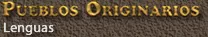

In [2]:
from bs4 import BeautifulSoup
soup = BeautifulSoup(html, "html.parser")
soup

In [3]:
table_list = soup.find("table", {"id": "aymara"}).find_all("tr")[2:]

In [4]:
len(table_list)

4968

In [5]:
table_list = [tr for tr in table_list if len(tr.find_all("td")) > 0]

In [6]:
import re

In [7]:
aymara_list = []
spanish_list = []
for i, row in enumerate(table_list):
    extract = re.findall(r"<td>(.*?)</td>", row.decode())
    extract = [re.sub(r"<.*?>", "", x) for x in extract]
    if len(extract) == 2:
        aymara_list.append(extract[0])
        spanish_list.append(extract[1])
    else:
        print(f"Error in row {i}: {row}")


In [8]:
print(len(aymara_list))
print(len(spanish_list))

4968
4968


In [9]:
import pandas as pd
table = pd.DataFrame({"aymara": aymara_list, "spanish": spanish_list})
table = table.drop_duplicates(subset=["aymara", "spanish"])
table = table.dropna()
table

,aymara,spanish
0,Acapacha,Mundo
1,Achachi,Persona de mucha edad. Viejo
2,Achachila,"Abuelo, anciano. Divinidad enmarcada en las mo..."
3,Achachilasanaka,Antepasados
4,Achachiña,Vejez
...,...,...
4963,Yuxch'a,Nuera
4964,Yyausaña,Fe
4965,Yä,Gusanillo que roe las papas
4966,Yäni,Que tiene el mayor grado posible de las cualid...


In [10]:
table.to_csv("data/diccionarios/aymara/dic-1-ay-es.csv", index=False)

## 2. Libro
https://aymaraclub.com/wp-content/uploads/2024/01/Diccionario-Aymara-Castellano-Teofilo-Laime-Virginia-Lucero-y-Mabel-Arteaga.pdf

In [11]:
import pymupdf # imports the pymupdf library

Se utilizara el formato dict debido a que es muy similar al resultado de un OCR, e incluye informacion como las coordenadas de bounding box (usadas para filtrar), y tipos de letra

In [12]:
doc = pymupdf.open("data/fuentes/aymara/Diccionario-Aymara-Castellano-Teofilo-Laime-Virginia-Lucero-y-Mabel-Arteaga.pdf") # open a document
texts = [] # create a list to store the text
for page in doc: # iterate the document pages
    text = page.get_text("dict") # get plain text encoded as UTF-8
    texts.append(text) # append the text to the list

In [13]:
texts[287]

{'width': 396.8500061035156,
 'height': 595.2760009765625,
 'blocks': [{'number': 0,
   'type': 0,
   'bbox': (330.7441101074219,
    556.4320678710938,
    347.2441101074219,
    570.8861083984375),
   'lines': [{'spans': [{'size': 11.0,
       'flags': 4,
       'bidi': 0,
       'char_flags': 16,
       'font': 'TimesNewRomanPSMT',
       'color': 0,
       'alpha': 255,
       'ascender': 1.0069999694824219,
       'descender': -0.3070000112056732,
       'text': '287',
       'origin': (330.7441101074219, 567.5090942382812),
       'bbox': (330.7441101074219,
        556.4320678710938,
        347.2441101074219,
        570.8861083984375)}],
     'wmode': 0,
     'dir': (1.0, 0.0),
     'bbox': (330.7441101074219,
      556.4320678710938,
      347.2441101074219,
      570.8861083984375)}]},
  {'number': 1,
   'type': 0,
   'bbox': (49.606292724609375,
    53.36701202392578,
    192.5162811279297,
    546.697021484375),
   'lines': [{'spans': [{'size': 10.0,
       'flags': 4,
   

### Procesar abreviaciones del diccionario
Diccionario de abreviaciones que contiene el diccionario.

In [14]:
characteristics_dict = {
    "a.": "Verbo reflexivo",
    "adj.": "Adjetivo",
    "adv.": "Adverbio",
    "Anat.": "Anatomía",
    "aprec.": "Apreciativo",
    "A-C": "Aymara-Castellano",
    "Biol.": "Biología",
    "Bot.": "Botánica",
    "c.": "Castellano",
    "C-A": "Castellano-Aymara",
    "conj.": "Conjunción",
    "cop.": "Verbo copulativo",
    "dem.": "Demostrativo",
    "despect.": "Despectivo",
    "dim.": "Diminutivo",
    "exist.": "Verbo existencial",
    "f.": "Femenino",
    "fam.": "Familiar",
    "fig.": "Sentido figurado",
    "fml.": "Registro formal",
    "Fon.": "Fonética, Fonología",
    "Gram.": "Gramática",
    "imper.": "Imperativo",
    "impers.": "Verbo impersonal",
    "indef.": "Indefinido",
    "infml.": "Registro informal",
    "i.": "Inglés",
    "interj.": "Interjección",
    "interr.": "Interrogativo",
    "intr.": "Verbo intransitivo",
    "Inv.": "Investigación",
    "Ling.": "Lingüística",
    "loc.": "Locución",
    "loc. n.": "Locución nominal",
    "m.": "Masculino",
    "Mat.": "Matemática",
    "neol.": "Neologismo",
    "p. p.": "Participio pasado",
    "pers.": "Personal",
    "pl.": "Plural",
    "pos.": "Posesivo",
    "posp.": "Posposición",
    "Prag.": "Pragmática",
    "prep.": "Preposición",
    "prest.": "Préstamo",
    "prnl.": "Verbo pronominal",
    "pron.": "Pronombre",
    "q.": "Quechua",
    "rec.": "Verbo recíproco",
    "s.": "Sustantivo",
    "sing.": "Singular",
    "sinón.": "Sinónimo",
    "Socling.": "Sociolingüística",
    "tr.": "Verbo transitivo",
    "v.": "Verbo",
    "vte.": "Variante",
    "Zool.": "Zoología",
    "|": "Lema variante o sinónimo",
    "||": "Otra acepción",
    "/ /": "Valor fonémico",
    "<": "Proviene de",
    ">": "Se convierte en",
    "[ ]": "Valor fonético",
    "&": "Y, relación",
}

In [22]:
pos_list = [
    "adjetivo",
    "adverbio",
    "conjunción",
    "demostrativo",
    "interjección",
    "verbo copulativo",
    "verbo existencial",
    "verbo impersonal",
    "interrogativo",
    "verbo intransitivo",
    "locución",
    "locución nominal",
    "posesivo",
    "posposición",
    "verbo pronominal",
    "preposición",
    "pronombre",
    "verbo recíproco",
    "sustantivo",
    "verbo transitivo",
    "verbo",
    "verbo reflexivo",
]

In [15]:
def process_fonetic(text: str):
    # Extract valor fonético [x:y]
    valor_fon_regex = re.search(r"\[.*?\]", text)
    if valor_fon_regex:
        valor_fon = valor_fon_regex.group()
        # Remove it from text to avoid confusion
        text = text.replace(valor_fon, "")
    return valor_fon

In [16]:
def process_characteristics(text: str, characteristics_dict: dict) -> list:
    """
    Process the text to extract the characteristics, according to the dictionary
    `characteristics_dict`.
    Args:
        text (str): The text to process.
    Returns:
        characteristics (list): The processed characteristics.

    Input example:
        text = "[á:a]. interj. & adj. loc. n."
    Output example:
        characteristics = [
            {
                "valor fonético": "[á:a]",
                "interjección": True,
                "adjetivo": True,
                "locución nominal": True,
            }
        ]
    """

    result = {}
    
    # Now handle the rest by matching known keys directly from the text
    remaining_text = text
    matched_keys = []

    # Sort keys from longest to shortest to avoid partial matching
    for key in sorted(characteristics_dict.keys(), key=lambda k: -len(k)):
        pattern = re.escape(key)
        matches = re.findall(rf'{pattern}', remaining_text)
        # print (f"Matches for {key} in {remaining_text}: {matches}")
        for _ in matches:
            matched_keys.append(key)
            # Remove only the first match per occurrence
            remaining_text = re.sub(rf'{pattern}', '', remaining_text, count=1)

    # Map to their full names
    for key in matched_keys:
        label = characteristics_dict[key]
        result[label.lower()] = True

    return result

In [17]:
# Ensure the cell defining `characteristics_dict` is executed before running this cell
result = process_characteristics("[á:a]. interj. & adj. loc. n. v. tr.", characteristics_dict)
result

{'interjección': True,
 'locución nominal': True,
 'adjetivo': True,
 'verbo transitivo': True,
 'verbo': True,
 'y, relación': True}

In [18]:
process_characteristics("(<c.)", characteristics_dict)

{'castellano': True, 'proviene de': True}

Funcion para agregar mas texto en un string

In [19]:
def add_definition(current_definition: str, new_definition: str) -> str:
    """
    Add a new definition to the current definition.
    Args:
        current_definition (str): The current definition.
        new_definition (str): The new definition to add.
    Returns:
        str: The updated definition.
    """
    current_definition += new_definition
    if len(current_definition) == 0:
        return current_definition
    current_definition = current_definition[:-1] if current_definition[-1] == "-" else current_definition + " "
    return current_definition

In [20]:
from pydantic_model import Definicion, Palabra, Sufijo, DefinicionSufijo, Posposicion

/Users/gersonvizcarra/.pyenv/versions/agents/lib/python3.12/site-packages/pydantic/_internal/_config.py:373: UserWarning: Valid config keys have changed in V2:
* 'anystr_strip_whitespace' has been renamed to 'str_strip_whitespace'
* 'min_anystr_length' has been renamed to 'str_min_length'
  warnings.warn(message, UserWarning)


### Limpieza del texto y contruccion de los objetos Definicion y Palabra

In [23]:
def clean_text(text: str) -> str:
    """
    Clean the text by removing unwanted characters and spaces.
    Args:
        text (str): The text to clean.
    Returns:
        str: The cleaned text.
    """
    # Remove extra spaces
    text = re.sub(r"\s+", " ", text).strip()
    return text

In [24]:
def build_definition(definition: str, characteristics: dict, variants: str,
                     synonyms: str, valor_fon: str = None) -> Definicion:
    """
    Build the definition object from the parameters.
    """
    pos = []
    otras_etiquetas = []
    for key in characteristics:
        if key.lower() in pos_list:
            pos.append(key)
        else:
            otras_etiquetas.append(key)
    
    pos = ", ".join(pos) if len(pos) > 0 else None
    otras_etiquetas = otras_etiquetas if len(otras_etiquetas) > 0 else None
    
    if valor_fon is not None:
        valor_fon = clean_text(valor_fon)
        valor_fon = valor_fon.lower().replace(".", "") if len(valor_fon) > 0 else None
    
    variants = clean_text(variants)
    if len(variants) == 0:
        variants = None
    else:
        variants = variants.lower().replace(".", "").split(",")
        variants = [variant.strip() for variant in variants]

    definition = clean_text(definition)
    new_variant = re.search(r"(V|v)er\s*([^a-z\,\.]+)\.", definition)
    if new_variant is not None:
        text_variant = new_variant.group(2).strip()
        definition = definition.replace(new_variant.group(), "")
        if variants is None:
            variants = [text_variant.lower()]
        else:
            variants.append(text_variant.lower())

    synonyms = clean_text(synonyms)
    if len(synonyms) == 0:
        synonyms = None
    else:
        synonyms = synonyms.lower().replace(".", "").split(",")
        synonyms = [synonym.strip() for synonym in synonyms]
    # Create the definition object
    definition_obj = Definicion(
        definicion=definition,
        pronunciacion=valor_fon,
        PoS=pos,
        otras_etiquetas=otras_etiquetas,
        variantes=variants,
        sinonimos=synonyms
    )
    return definition_obj

In [25]:
build_definition(
    definition="definición",
    characteristics={
        "interjección": True,
        "adjetivo": True,
        "locución nominal": True,
        "zoología": True,
        "valor fonético": "[á:a]"
    },
    variants="variante 1, variante 2",
    synonyms="sinónimo 1, sinónimo 2"
)

Definicion(definicion='definición', pronunciacion=None, PoS='interjección, adjetivo, locución nominal', otras_etiquetas=['zoología', 'valor fonético'], sinonimos=['sinónimo 1', 'sinónimo 2'], variantes=['variante 1', 'variante 2'])

In [26]:
import string

In [27]:
def build_word(word: str, definitions: list):
    """
    Build the word object from the parameters.
    """
    # Clean the word
    if word[-1] in [",", ".", "(", ":"]:
        word = word[:-1]
    word = clean_text(word)
    if "(" in word and ")" in word:
        origen = re.search(r"\((.*?)\)", word).group(1) + "."
        text_origen = characteristics_dict.get(origen[0], "") + " " + characteristics_dict.get(f"{origen[1]}.", "")
        if text_origen.strip() != "":
            if definitions[0].otras_etiquetas is not None:
                definitions[0].otras_etiquetas.append(text_origen)
            else:
                definitions[0].otras_etiquetas = [text_origen]
        word = re.sub(r"\(.*?\)", "", word).strip()
    
    if len(definitions) == 0:
        print("Error in word:", word)
    
    pronunciaciones = []
    PoS = []
    sinonimos = []
    for definition in definitions:
        if definition.pronunciacion is not None:
            pronunciaciones.append(definition.pronunciacion)
        if definition.PoS is not None:
            PoS.append(definition.PoS)
        if definition.sinonimos is not None:
            sinonimos.extend(definition.sinonimos)
    
    # Create the word object
    word_obj = Palabra(
        palabra=word,
        definiciones=definitions,
        pronunciaciones=pronunciaciones,
        PoS=PoS,
        sinonimos_comunes=sinonimos,
    )
    return word_obj

In [28]:
build_word("a (<c)", [Definicion(definicion="a", pronunciacion="[á:a]", PoS="Adjetivo")])

Palabra(palabra='a', definiciones=[Definicion(definicion='a', pronunciacion='[á:a]', PoS='Adjetivo', otras_etiquetas=['Proviene de Castellano'], sinonimos=None, variantes=None)], pronunciaciones=['[á:a]'], PoS=['Adjetivo'], sinonimos_comunes=[])

### Lectura del PDF con filtros de coordenadas

In [29]:
from unidecode import unidecode

In [30]:
from typing import List, Tuple

def get_text_dicts(document: pymupdf.Document, page_start: int, page_end: int, clip_coords: List[Tuple]):
    """
    Get the text dicts from the pages of the PDF.
    Args:
        page_start (int): The start page.
        page_end (int): The end page.
        clip_coords (List[Tuple]): The coordinates to clip the text, can be multiple
        rectangles.
    Returns:
        list: The text from the pages.
    """
    pages = document.pages(page_start, page_end)
    for i, page in enumerate(pages):
        for j, clip_coord in enumerate(clip_coords):
            if i == 0 and j == 0:
                text_dict = page.get_text("dict", clip=clip_coord)
                continue
            text_dict["blocks"].extend(page.get_text("dict", clip=clip_coord)["blocks"])
    return text_dict

In [31]:
col1_left_coordinate = 45
col1_top_coordinate = 50

col1_right_coordinate = 198
col1_bottom_coordinate = 550
first_col_clip = (col1_left_coordinate, col1_top_coordinate, col1_right_coordinate, col1_bottom_coordinate)

col2_left_coordinate = 200
col2_top_coordinate = 50

col2_right_coordinate = 355
col2_bottom_coordinate = 550
second_col_clip = (col2_left_coordinate, col2_top_coordinate, col2_right_coordinate, col2_bottom_coordinate)

In [32]:
text_dict = get_text_dicts(doc, 31, 282, [first_col_clip, second_col_clip])
text_dict

{'width': 153.0,
 'height': 500.0,
 'blocks': [{'number': 0,
   'type': 0,
   'bbox': (49.606300354003906,
    48.323326110839844,
    192.50135803222656,
    412.0173034667969),
   'lines': [{'spans': [{'size': 22.768400192260742,
       'flags': 20,
       'bidi': 0,
       'char_flags': 16,
       'font': 'TimesNewRomanPS-BoldMT',
       'color': 0,
       'alpha': 255,
       'ascender': 1.0260000228881836,
       'descender': -0.3070000112056732,
       'text': 'A',
       'origin': (112.560302734375, 72.94732666015625),
       'bbox': (112.560302734375,
        48.323326110839844,
        128.15550231933594,
        80.31532287597656)}],
     'wmode': 0,
     'dir': (1.0, 0.0),
     'bbox': (112.560302734375,
      48.323326110839844,
      128.15550231933594,
      80.31532287597656)},
    {'spans': [{'size': 10.0,
       'flags': 4,
       'bidi': 0,
       'char_flags': 16,
       'font': 'TimesNewRomanPSMT',
       'color': 0,
       'alpha': 255,
       'ascender': 1.0069999

### Funcion de extraccion de las palabras del diccionario 

In [33]:
import copy

In [34]:
def extract_text_from_dict(text_dict: dict):
    word_list = []
    
    reset_values = {
        "palabra": "",
        "definicion": "",
        "caracteristicas": {},
        "sinonimos": "",
        "variantes": "",
        "valor_fon": "",
        "flag_variante": False,
        "flag_sinonimo": False,
        "flag_valor_fon": False,
    }
    definition_list = []
    current_values = copy.deepcopy(reset_values)

    for block in text_dict["blocks"]:
        if "lines" not in block:
            print("No lines in block")
            print(block["bbox"])
            print(f"last word processed: {word_list[-1]}")
            print(f"current word processed: {current_values["palabra"]}")
            continue
        for line in block["lines"]:
            for span in line["spans"]:
                if "text" not in span:
                    continue
                tmp_text = span["text"].strip()
                if len(tmp_text) == 0:
                    continue
                match span["font"]:
                    case "TimesNewRomanPS-BoldMT":
                        if span["size"] > 10.5:
                            continue
                        if span["bbox"][0] > 210 or (span["bbox"][0] < 200 and span["bbox"][0] > 55):
                            continue
                        if current_values["palabra"] != "":
                            def_obj = build_definition(current_values["definicion"],
                                                       current_values["caracteristicas"],
                                                       current_values["variantes"],
                                                       current_values["sinonimos"],
                                                       current_values["valor_fon"])
                            definition_list.append(def_obj)
                            word = build_word(current_values["palabra"], definition_list)
                            word_list.append(word)
                            current_values = copy.deepcopy(reset_values)
                            definition_list = []
                        current_values["palabra"] = tmp_text[:-1] if tmp_text[-1] == "." else tmp_text
                    case "TimesNewRomanPS-ItalicMT":
                        if "sinon" in unidecode(tmp_text):
                            current_values["flag_sinonimo"] = True
                            current_values["flag_variante"] = False
                            continue
                        chars = process_characteristics(tmp_text, characteristics_dict)
                        current_values["caracteristicas"].update(chars)

                    case "TimesNewRomanPSMT":
                        if "[" in tmp_text:
                            # TODO: Fix regex to match [á:a. and [á:a] regardless of the "]"
                            fonetic = re.search(r"\[[^\]]*(?:\]|$)", tmp_text).group(0)
                            current_values["valor_fon"] = add_definition(current_values["valor_fon"], fonetic) if current_values["flag_valor_fon"] else fonetic
                            closing = re.search(r"\]\s*\.", tmp_text)
                            if not closing:
                                current_values["flag_valor_fon"] = True
                                continue
                            else:
                                current_values["flag_valor_fon"] = False
                                tmp_text = re.sub(r".*?]\s*\.", "", tmp_text)
                            
                        if "||" in tmp_text:
                            first_def, second_def = tmp_text.split("||")
                            if current_values["flag_variante"]:
                                current_values["variantes"] = add_definition(current_values["variantes"], first_def)
                                current_values["flag_variante"] = False
                            elif current_values["flag_sinonimo"]:
                                current_values["sinonimos"] = add_definition(current_values["sinonimos"], first_def)
                                current_values["flag_sinonimo"] = False
                            else:
                                current_values["definicion"] = add_definition(current_values["definicion"], first_def)
                            # Build definition object
                            def_obj = build_definition(current_values["definicion"],
                                                       current_values["caracteristicas"],
                                                       current_values["variantes"],
                                                       current_values["sinonimos"])
                            definition_list.append(def_obj)
                            current_values["definicion"] = add_definition("", re.sub(r"\s*\d+\.?\s*", "",second_def))
                            current_values["caracteristicas"] = {}
                            current_values["sinonimos"] = ""
                            current_values["variantes"] = ""
                            
                        elif "|" in tmp_text:
                            if tmp_text[-1] == "|":
                                first_def = tmp_text[:-1]
                                second_def = ""
                            else:
                                first_def, second_def = tmp_text.split("|")
                            current_values["definicion"] = add_definition(current_values["definicion"], first_def)
                            current_values["variantes"] = add_definition(current_values["variantes"], second_def) if second_def != "" else ""
                            current_values["flag_variante"] = True
                        else:
                            if current_values["flag_variante"]:
                                current_values["variantes"] = add_definition(current_values["variantes"], tmp_text)
                            elif current_values["flag_sinonimo"]:
                                current_values["sinonimos"] = add_definition(current_values["sinonimos"], tmp_text)
                            elif current_values["flag_valor_fon"]:
                                current_values["valor_fon"] = add_definition(current_values["valor_fon"], tmp_text)
                                closing = re.search(r"\]\s*\.", tmp_text)
                                if closing:
                                    current_values["flag_valor_fon"] = False
                            else:
                                current_values["definicion"] = add_definition(current_values["definicion"], tmp_text)
                    case "TimesNewRomanPSMT-SC900":
                        if current_values["flag_variante"]:
                            current_values["variantes"] = add_definition(current_values["variantes"], tmp_text)
                        else:
                            current_values["definicion"] = add_definition(current_values["definicion"], tmp_text.upper())
    
    def_obj = build_definition(current_values["definicion"],
                                current_values["caracteristicas"],
                                current_values["variantes"],
                                current_values["sinonimos"],
                                current_values["valor_fon"])
    definition_list.append(def_obj)
    word = build_word(current_values["palabra"], definition_list)
    word_list.append(word)
         
    return word_list

word_list = extract_text_from_dict(text_dict)


No lines in block
(55.56968688964844, 415.9588317871094, 183.9578857421875, 540.850830078125)
last word processed: palabra='achakana' definiciones=[Definicion(definicion='Cacto comestible similar a la zanahoria que crece al ras de la tierra.', pronunciacion=None, PoS='sustantivo', otras_etiquetas=None, sinonimos=None, variantes=None)] pronunciaciones=[] PoS=['sustantivo'] sinonimos_comunes=[]
current word processed: achaku
No lines in block
(206.92913818359375, 456.51220703125, 347.24407958984375, 538.4510498046875)
last word processed: palabra='ampar wayaqa' definiciones=[Definicion(definicion='Bolsa de mano. Cartera de mujer ( MM & VCh).', pronunciacion=None, PoS='sustantivo', otras_etiquetas=None, sinonimos=None, variantes=None)] pronunciaciones=[] PoS=['sustantivo'] sinonimos_comunes=[]
current word processed: ampara
No lines in block
(214.66749572753906, 401.8114013671875, 339.5057373046875, 538.1702880859375)
last word processed: palabra='anu qallu' definiciones=[Definicion(defin

In [35]:
len(word_list)

6996

In [36]:
# TODO: Incluir palabras que no esten en negrita revisando sangria pp:41, 165
# TODO: Arreglar el procesamiento de palabras en negrita en pronunciacion pp: 135, 165, temporalmente se ignoraron
# TODO: Agregar procesamiento de caracteristicas multilinea pp: 49
# TODO: Parsear sufijos, primero busqueda por palabra y luego por sufijo y ver si se la palabra restante
# CHECK TODO: Unificar lista de palabras en autentico diccionario.
# CHECK TODO: Realizar el procesamiento de la ultima palabra del diccionario (no se encuentra otro bold y no se agrega al diccionario)

In [37]:
first_col_clip_suffix = (45, 50, 198, 160)
second_col_clip_suffix = (200, 50, 355, 160)

In [38]:
suffix_pages = get_text_dicts(doc, 284, 291, [first_col_clip, second_col_clip])
suffix_dict_2 = get_text_dicts(doc, 292, 293, [first_col_clip_suffix, second_col_clip_suffix])
print(len(suffix_pages["blocks"]))
suffix_pages["blocks"].extend(suffix_dict_2["blocks"])
print(len(suffix_pages["blocks"]))

14
16


### Extraccion de los sufijos

In [39]:
def add_sufijo(sufijo: str, descripcion: str, sufijo_list: List):
    descripcion_str = descripcion.split(".")
    for i, substr in enumerate(descripcion_str):
        if ";" in substr or "," in substr:
            tipo_naturaleza = substr.split(";") if ";" in substr else substr.split(",")
            descripcion_str = ".".join(descripcion_str).replace(substr, "").strip()
            tipo, naturaleza = tipo_naturaleza[0], tipo_naturaleza[1]
            break
    
    pattern = r"\s*\((.*?)\)"
    definiciones = re.finditer(pattern, sufijo)
    definicion_list = []
    for definicion in definiciones:
        definicion = definicion.group(1)
        definicion_list.append(definicion)
    definition_str = ", ".join(definicion_list)
    
    sufijo = re.sub(pattern, "", sufijo)
    sufijo = re.sub(r"\s+", " ", sufijo).strip()
    sufijos = sufijo.split("/")
    for sufijo in sufijos:
        if len(sufijo) == 0:
            continue
        sufijo = sufijo.strip().replace("–", "").replace("-", "")
        definicion_obj = DefinicionSufijo(
            definicion=definition_str,
            descripcion=descripcion_str,
            tipo=tipo,
            naturaleza=naturaleza,
        )
        sufijo_obj = Sufijo(
            sufijo=sufijo,
            definiciones=[definicion_obj],
        )
        sufijo_list.append(sufijo_obj)

In [40]:
def extract_sufijos(text_dict: dict):
    suffix_list = []
    
    reset_values = {
        "sufijo": "",
        "descripcion": "",
    }
    current_values = copy.deepcopy(reset_values)

    for block in text_dict["blocks"]:
        if "lines" not in block:
            print("No lines in block")
            print(block)
            print(block["bbox"])
            print(f"last word processed: {word_list[-1]}")
            print(f"current word processed: {current_values["palabra"]}")
            continue
        for line in block["lines"]:
            for span in line["spans"]:
                if "text" not in span:
                    continue
                tmp_text = span["text"].strip()
                if len(tmp_text) == 0:
                    continue
                match span["font"]:
                    case "TimesNewRomanPS-BoldMT":
                        if span["size"] > 10.5:
                            continue
                        if span["bbox"][0] > 217 or (span["bbox"][0] < 200 and span["bbox"][0] > 60):
                            continue
                        if current_values["sufijo"] != "" and current_values["descripcion"] != "" and tmp_text[0] != "…":
                            add_sufijo(current_values["sufijo"],
                                       current_values["descripcion"],
                                       suffix_list)
                            current_values = copy.deepcopy(reset_values)
                        current_values["sufijo"] = add_definition(current_values["sufijo"], tmp_text[:-1] if tmp_text[-1] == "." else tmp_text)

                    case "TimesNewRomanPSMT":
                        current_values["descripcion"] = add_definition(current_values["descripcion"], tmp_text)
    
    add_sufijo(current_values["sufijo"],
               current_values["descripcion"],
               suffix_list)
         
    return suffix_list

In [41]:
suffix_list = extract_sufijos(suffix_pages)

In [42]:
word_dict = {}
for word in word_list:
    if word.palabra not in word_dict:
        word_dict[word.palabra] = word
        continue
    existing_word = word_dict[word.palabra]
    
    for definition in word.definiciones:
        variants = definition.variantes
        if variants is None or len(variants) == 0:
            continue
        for variant in variants:
            if variant in word_dict:
                word_dict[variant].definiciones.append(definition)
                word_dict[word.palabra].definiciones.extend(word_dict[variant].definiciones)
                word_dict[word.palabra].pronunciaciones.extend(word_dict[variant].pronunciaciones)
                word_dict[word.palabra].PoS.extend(word_dict[variant].PoS)
                word_dict[word.palabra].sinonimos_comunes.extend(word_dict[variant].sinonimos_comunes)
            else:
                pronunciaciones = [] if definition.pronunciacion is None else [definition.pronunciacion]
                PoS = [] if definition.PoS is None else [definition.PoS]
                sinonimos = [] if definition.sinonimos is None else definition.sinonimos
                word_dict[variant] = Palabra(
                    palabra=variant,
                    definiciones=[definition],
                    pronunciaciones=pronunciaciones,
                    PoS=PoS,
                    sinonimos_comunes=sinonimos,
                )

    # If the word is already in the dictionary, merge the definitions
    existing_word.definiciones.extend(word.definiciones)
    existing_word.pronunciaciones.extend(word.pronunciaciones)
    existing_word.PoS.extend(word.PoS)
    existing_word.sinonimos_comunes.extend(word.sinonimos_comunes)
    
    # Remove duplicates definitions in the word object
    existing_word.definiciones = list({d.definicion: d for d in existing_word.definiciones}.values())
    existing_word.pronunciaciones = list({d: d for d in existing_word.pronunciaciones}.values())
    existing_word.PoS = list({d: d for d in existing_word.PoS}.values())
    existing_word.sinonimos_comunes = list({d: d for d in existing_word.sinonimos_comunes}.values())


In [43]:
sufijo_dict = {}
for sufijo in suffix_list:
    if sufijo.sufijo not in sufijo_dict:
        sufijo_dict[sufijo.sufijo] = sufijo
        continue
    existing_sufijo = sufijo_dict[sufijo.sufijo]
    
    # If the word is already in the dictionary, append to definiciones list
    existing_sufijo.definiciones.extend(sufijo.definiciones)
sufijo_dict

{'cha': Sufijo(sufijo='cha', definiciones=[DefinicionSufijo(definicion='factitivo', descripcion='. Pampachaña ‘aplanar’.', tipo='Verbalizador', naturaleza=' de naturaleza normal'), DefinicionSufijo(definicion='inferencial', descripcion='. Jupacha ‘tal vez es él/ella’.', tipo='Independiente oracional', naturaleza=' de naturaleza normal'), DefinicionSufijo(definicion='interrogativo de alternancia', descripcion='. ¿Jupati jumacha saräta? ‘¿él va o tú vas?’', tipo='Independiente oracional', naturaleza=' de naturaleza normal')]),
 'chi': Sufijo(sufijo='chi', definiciones=[DefinicionSufijo(definicion='diminutivo fútil', descripcion='. Paquchi ‘rubiecito’.', tipo='Derivativo nominal', naturaleza=' de naturaleza normal'), DefinicionSufijo(definicion='extremativo', descripcion='. Munachi ‘ambicioso; amuleto de amor’.', tipo='Nominalizador', naturaleza=' de naturaleza normal'), DefinicionSufijo(definicion='dubitativo', descripcion='. Qillqchi ‘(él) tal vez escribe’.', tipo='Flexivo verbal', natu

In [52]:
print(len(word_dict))
print(len(sufijo_dict))

6512
137


In [46]:
word_dict["axsaraña"]

Palabra(palabra='axsaraña', definiciones=[Definicion(definicion='Desconfiar. No confiar, no estar seguro de alguien o algo. Dudar, recelar, temer.', pronunciacion=None, PoS='verbo intransitivo, verbo', otras_etiquetas=None, sinonimos=None, variantes=['asxaraña']), Definicion(definicion='Miedo. Angustia, temor ante un peligro.', pronunciacion=None, PoS='sustantivo', otras_etiquetas=None, sinonimos=None, variantes=None), Definicion(definicion='Temer. Sentir temor de alguien o algo.', pronunciacion=None, PoS='verbo transitivo, verbo', otras_etiquetas=None, sinonimos=None, variantes=None)], pronunciaciones=[], PoS=['verbo intransitivo, verbo', 'sustantivo', 'verbo transitivo, verbo'], sinonimos_comunes=[])

### Diccionario de las posposiciones
No se realizara la extraccion ya que son solo 13 posposiciones

In [44]:
posposiciones = [
    Posposicion(
        posposicion="chaqa",
        definicion="locativo",
        condicion="Posposición de condición semifuerte",
        ejemplo="Aka chaqa ‘este sitio’",
    ),
    Posposicion(
        posposicion="chika",
        definicion="comitativo",
        condicion="Posposición de condición semifuerte",
        ejemplo="Juma chika ‘contigo’",
    ),
    Posposicion(
        posposicion="kayu",
        definicion="inferior",
        condicion="Posposición de condición semifuerte",
        ejemplo="Qullu kayu ‘faldas del cerro’",
    ),
    Posposicion(
        posposicion="laka",
        definicion="periférico inicial",
        condicion="Posposición de condición semifuerte",
        ejemplo="Quta laka ‘orilla del lago’",
    ),
    Posposicion(
        posposicion="lala",
        definicion="diminutivo",
        condicion="Posposición de condición normal",
        ejemplo="Khaych’a lala ‘tan pequeño aquél’",
    ),
    Posposicion(
        posposicion="lanti",
        definicion="sustitutivo",
        condicion="Posposición de condición semifuerte",
        ejemplo="Jupa lanti ‘en lugar de ella’",
    ),
    Posposicion(
        posposicion="manqhi",
        definicion="profundo",
        condicion="Posposición de condición semifuerte",
        ejemplo="Uta manqhi ‘al interior de la casa’",
    ),
    Posposicion(
        posposicion="pachpa",
        definicion="identitario",
        condicion="Posposición de condición semifuerte",
        ejemplo="Jiwasa pachpa ‘nosotros mismos’",
    ),
    Posposicion(
        posposicion="pata",
        definicion="superficial / superior",
        condicion="Posposición de condición semifuerte",
        ejemplo="Uta pata ‘techo’",
    ),
    Posposicion(
        posposicion="qallu",
        definicion="diminutivo de animales",
        condicion="Posposición de condición semifuerte",
        ejemplo="Iwis qallu ‘cría de oveja’",
    ),
    Posposicion(
        posposicion="taqi",
        definicion="aumentativo",
        condicion="Posposición de condición normal",
        ejemplo="Khaych’a taqi ‘tan grande aquél’",
    ),
    Posposicion(
        posposicion="thiya",
        definicion="periférico terminal",
        condicion="Posposición de condición semifuerte",
        ejemplo="Jawir thiya ‘orilla del río’",
    ),
    Posposicion(
        posposicion="tuqi",
        definicion="lateral",
        condicion="Posposición de condición semifuerte",
        ejemplo="Uka tuqi ‘ese lado’",
    ),
]

In [47]:
posposicion_dict = {}
for posposicion in posposiciones:
    if posposicion.posposicion not in posposicion_dict:
        posposicion_dict[posposicion.posposicion] = posposicion
        continue

In [51]:
posposicion_dict

{'chaqa': Posposicion(posposicion='chaqa', definicion='locativo', condicion='Posposición de condición semifuerte', ejemplo='Aka chaqa ‘este sitio’'),
 'chika': Posposicion(posposicion='chika', definicion='comitativo', condicion='Posposición de condición semifuerte', ejemplo='Juma chika ‘contigo’'),
 'kayu': Posposicion(posposicion='kayu', definicion='inferior', condicion='Posposición de condición semifuerte', ejemplo='Qullu kayu ‘faldas del cerro’'),
 'laka': Posposicion(posposicion='laka', definicion='periférico inicial', condicion='Posposición de condición semifuerte', ejemplo='Quta laka ‘orilla del lago’'),
 'lala': Posposicion(posposicion='lala', definicion='diminutivo', condicion='Posposición de condición normal', ejemplo='Khaych’a lala ‘tan pequeño aquél’'),
 'lanti': Posposicion(posposicion='lanti', definicion='sustitutivo', condicion='Posposición de condición semifuerte', ejemplo='Jupa lanti ‘en lugar de ella’'),
 'manqhi': Posposicion(posposicion='manqhi', definicion='profundo

### Exportado de los datos

In [53]:
import json

In [ ]:
# Export pydantic dictionary to JSON
def export_to_json(data, filename):
    with open(filename, "w", encoding="utf-8") as f:
        json.dump(data, f, ensure_ascii=False, indent=4)
    with open(filename, "r", encoding="utf-8") as f:
        data = json.load(f)
    return data
# Export words


In [ ]:
with open("data/diccionarios/aymara/dic-2-ay-es.json", "w", encoding="utf-8") as f:
    json.dump(
        {
            "diccionario": "Diccionario Aymara-Castellano",
            "version": 1,
            "fecha": "2023-10-10",
            "fuente": "Teofilo Laime y Virginia Lucero y Mabel Arteaga",
            "palabras": {key: value.dict() for key, value in word_dict.items()},
            "sufijos": {key: value.dict() for key, value in sufijo_dict.items()},
            "posposiciones": {key: value.dict() for key, value in posposicion_dict.items()},
        },
        f,
        ensure_ascii=False,
        indent=4,
    )

/var/folders/nv/8yp8fxq951gcc63w9by2vg840000gn/T/ipykernel_6148/2247490820.py:8: PydanticDeprecatedSince20: The `dict` method is deprecated; use `model_dump` instead. Deprecated in Pydantic V2.0 to be removed in V3.0. See Pydantic V2 Migration Guide at https://errors.pydantic.dev/2.11/migration/
  "palabras": {key: value.dict() for key, value in word_dict.items()},
/var/folders/nv/8yp8fxq951gcc63w9by2vg840000gn/T/ipykernel_6148/2247490820.py:9: PydanticDeprecatedSince20: The `dict` method is deprecated; use `model_dump` instead. Deprecated in Pydantic V2.0 to be removed in V3.0. See Pydantic V2 Migration Guide at https://errors.pydantic.dev/2.11/migration/
  "sufijos": {key: value.dict() for key, value in sufijo_dict.items()},
/var/folders/nv/8yp8fxq951gcc63w9by2vg840000gn/T/ipykernel_6148/2247490820.py:10: PydanticDeprecatedSince20: The `dict` method is deprecated; use `model_dump` instead. Deprecated in Pydantic V2.0 to be removed in V3.0. See Pydantic V2 Migration Guide at https://e

In [ ]:
# load to pydantic objects
with open("data/diccionarios/aymara/dic-2-ay-es.json", "r", encoding="utf-8") as f:
    data = json.load(f)
    data = {
        "diccionario": data["diccionario"],
        "version": data["version"],
        "fecha": data["fecha"],
        "fuente": data["fuente"],
        "palabras": {key: Palabra(**value) for key, value in data["palabras"].items()},
        "sufijos": {key: Sufijo(**value) for key, value in data["sufijos"].items()},
        "posposiciones": {key: Posposicion(**value) for key, value in data["posposiciones"].items()},
    }

In [57]:
data

{'diccionario': 'Diccionario Aymara-Castellano',
 'version': 1,
 'fecha': '2023-10-10',
 'fuente': 'Teofilo Laime y Virginia Lucero y Mabel Arteaga',
 'palabras': {'äa!': Palabra(palabra='äa!', definiciones=[Definicion(definicion='Expresión para manifestar que “ahora ya entiendo o he comprendido”. Se responde así cuando se recibe una segunda explicación de algún asunto.', pronunciacion='[á:a]', PoS='interjección', otras_etiquetas=None, sinonimos=None, variantes=None)], pronunciaciones=['[á:a]'], PoS=['interjección'], sinonimos_comunes=[]),
  'acha': Palabra(palabra='acha', definiciones=[Definicion(definicion='Hacha. Herramienta para cortar leña o los huesos de la carne.', pronunciacion=None, PoS='sustantivo', otras_etiquetas=['Proviene de Castellano'], sinonimos=['k’uthaña', 'liq’jaña'], variantes=None)], pronunciaciones=[], PoS=['sustantivo'], sinonimos_comunes=['k’uthaña', 'liq’jaña']),
  'achachi': Palabra(palabra='achachi', definiciones=[Definicion(definicion='Viejo. Animal macho d

#### Column 1

In [ ]:
left_coordinate_book = 49.11029815673828
top_coordinate_book = 53.20701446533203


right_coordinate_book = 192.41 # podria ser 198
bottom_coordinate_book = 546.70


In [ ]:
col1_left_coordinate = 45
col1_top_coordinate = 50

col1_right_coordinate = 198
col1_bottom_coordinate = 550

#### Column 2

In [ ]:
left_coordinate_book = 206.92660522460938 # podria ser 200
top_coordinate_book = 53.20673370361328 # podria ser 50


right_coordinate_book = 349.750 # podria ser 355
bottom_coordinate_book = 546.70 # podria ser 550

In [ ]:
col2_left_coordinate = 200
col2_top_coordinate = 50

col2_right_coordinate = 355
col2_bottom_coordinate = 550

- Puede haber mas de una definicion de una palabra, incluso si la primera definicion ya tenia dos bloques, se debe combinar
